In [3]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import numba as nb
import matplotlib.animation as animation
from IPython.display import HTML

In [4]:
def wave_equation(current_state, previous_state, c, dt, dx):
    coefficient = c * c * dt * dt / dx / dx
    new_state = np.zeros_like(current_state)
    for i in range(1, new_state.size-1):
        new_state[i] = coefficient * (current_state[i+1] + current_state[i-1] - 2 * current_state[i]) - previous_state[i] + 2 * current_state[i]
    return new_state

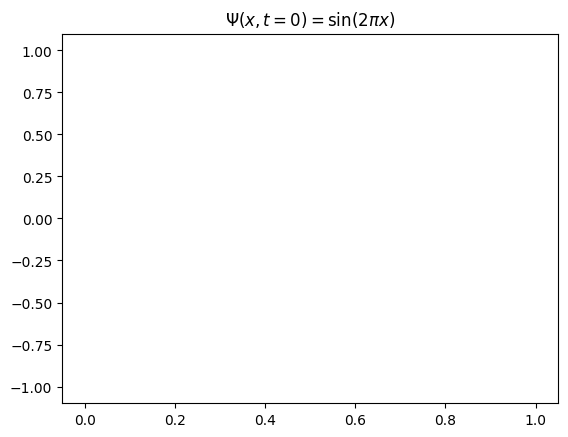

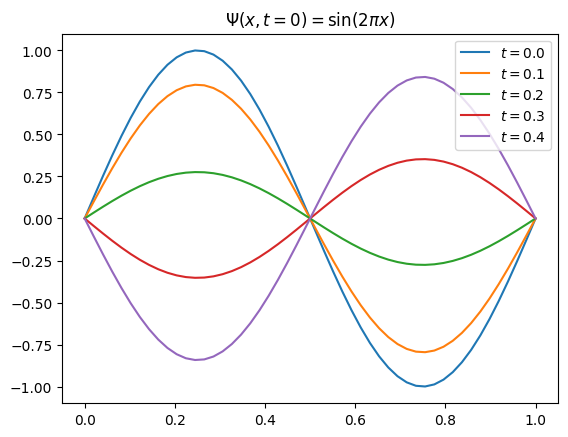

In [17]:
fig, ax = plt.subplots()
fig2, ax2 = plt.subplots()
artists = []
# Case 1
L = 1
N = 50
c = 1
dt = .001
dx = L / N
nodes = np.linspace(0, 1, N)
state = np.array([np.sin(np.pi * 2 * x) for x in nodes])
previous_state = state
current_state = state
for t in range(500):
    new_state = wave_equation(current_state, previous_state, c, dt, dx)
    previous_state = current_state
    current_state = new_state
    container = ax.plot(nodes, current_state, color='k')
    artists.append(container)
    if t % 100 == 0:
        ax2.plot(nodes, current_state, label=r'$t={}$'.format(t*dt))

ax.set_title(r"$\Psi(x,t=0) = \sin(2\pi x)$")
ax2.set_title(r"$\Psi(x,t=0) = \sin(2\pi x)$")
plt.legend()
ani = animation.ArtistAnimation(fig=fig, artists=artists, interval=400)
HTML(ani.to_jshtml())


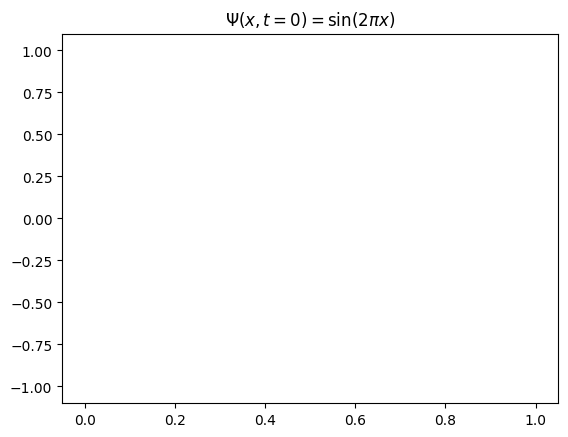

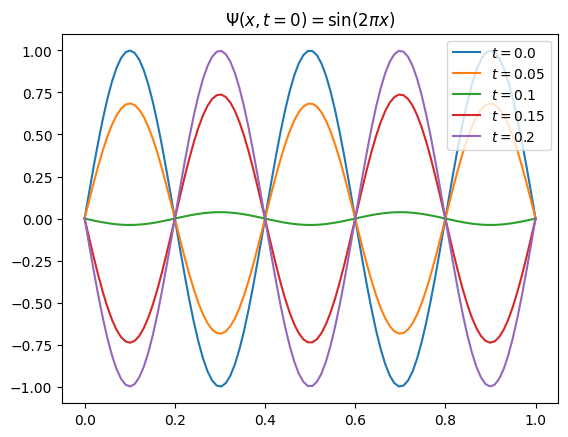

In [13]:
fig, ax = plt.subplots()
fig2, ax2 = plt.subplots()
artists = []
# Case 2
L = 1
N = 100
c = 1
dt = .001
dx = L / N
nodes = np.linspace(0, 1, N)
state = np.array([np.sin(np.pi * 5 * x) for x in nodes])
previous_state = state
current_state = state
for t in range(250):
    new_state = wave_equation(current_state, previous_state, c, dt, dx)
    previous_state = current_state
    current_state = new_state
    container = ax.plot(nodes, current_state, color='k')
    artists.append(container)
    if t % 50 == 0:
        ax2.plot(nodes, current_state, label=r'$t={}$'.format(t*dt))

plt.legend()

ax.set_title(r"$\Psi(x,t=0) = \sin(5\pi x)$")
ax2.set_title(r"$\Psi(x,t=0) = \sin(5\pi x)$")
ani = animation.ArtistAnimation(fig=fig, artists=artists, interval=400)
HTML(ani.to_jshtml())


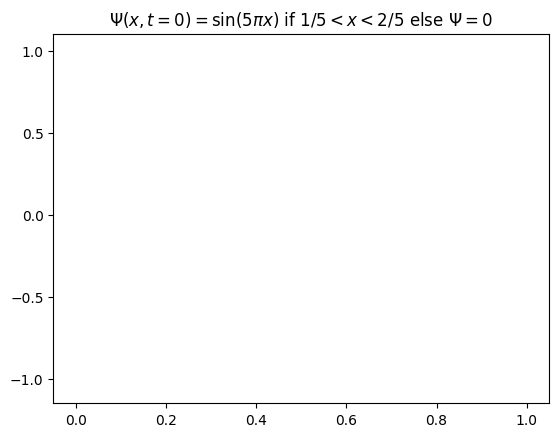

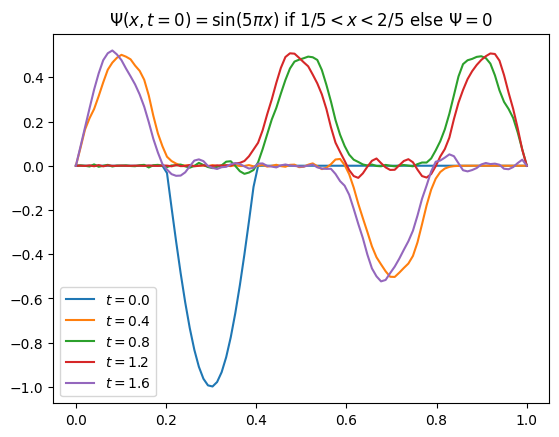

In [16]:
fig, ax = plt.subplots()
fig2, ax2 = plt.subplots()
artists = []
# Case 3
L = 1
N = 100
c = 1
dt = .001
dx = L / N
nodes = np.linspace(0, 1, N)
state = np.array([np.sin(np.pi * 5 * x) if (x > 1/5 and x < 2/5) else 0 for x in nodes])
previous_state = state
current_state = state
for t in range(2000):
    new_state = wave_equation(current_state, previous_state, c, dt, dx)
    previous_state = current_state
    current_state = new_state
    if t % 20 == 0:
        container = ax.plot(nodes, current_state, color='k')
        artists.append(container)
    if t % 400 == 0:
        ax2.plot(nodes, current_state, label=r'$t={}$'.format(t * dt))

plt.legend()

ax.set_title(r"$\Psi(x,t=0) = \sin(5\pi x)$ if $1/5 < x < 2/5$ else $\Psi = 0$")
ax2.set_title(r"$\Psi(x,t=0) = \sin(5\pi x)$ if $1/5 < x < 2/5$ else $\Psi = 0$")
ani = animation.ArtistAnimation(fig=fig, artists=artists, interval=50)
HTML(ani.to_jshtml())
# ani.save('animation.gif')
